# Herroin Overdose Analysis of Cincinnati, Ohio

## MUSA 620 Final Project

Shuyan Hong & Jiazuo Zhang

## 1. Exploratory Analysis

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import folium
from matplotlib import pyplot as plt
import cartopy.crs as ccrs

Import overdose data.

In [2]:
#Overdose data
query = ("https://data.cincinnati-oh.gov/resource/7mtn-nnb5.json?$limit=10000")
raw_data = pd.read_json(query)
raw_data.head()

,address_x,agency,arrival_time_primary_unit,beat,closed_time_incident,community_council_neighborhood,create_time_incident,dispatch_time_primary_unit,disposition_text,district,event_number,incident_type_desc,incident_type_id,latitude_x,longitude_x,priority,priority_color
0,W 6TH ST / RACE ST,CPD,NaN,P011,2018-08-18T23:13:00.000,DOWNTOWN,2018-08-18T23:04:31.000,NaN,HBF: HANDLED BY FIRE,1.0,CPD180818001582,NaN,HEROINP-COMBINED,39.101675,-84.514038,2.0,NaN
1,8XX POPLAR ST,CPD,2018-08-18T20:24:30.000,P131,2018-08-18T20:36:04.000,WEST END,2018-08-18T20:19:46.000,2018-08-18T20:21:50.000,HBF: HANDLED BY FIRE,1.0,CPD180818001335,NaN,HEROINP-COMBINED,39.115051,-84.529110,2.0,NaN
2,47XX KENARD AV,CPD,2018-08-18T19:03:33.000,P531,2018-08-18T21:48:01.000,SPRING GROVE VILLAGE,2018-08-18T19:03:33.000,2018-08-18T19:03:33.000,ARR: ARREST,5.0,CPD180818001232,NaN,HEROINP-COMBINED,39.164528,-84.513777,2.0,NaN
3,4XX VOLKERT PL,CPD,NaN,P511,2018-08-18T18:18:34.000,CUF,2018-08-18T18:00:54.000,NaN,HBF: HANDLED BY FIRE,5.0,CPD180818001142,NaN,HEROINP-COMBINED,39.126231,-84.525635,2.0,NaN
4,42XX FERGUS ST,CPD,2018-08-18T16:22:25.000,P531,2018-08-18T16:55:58.000,NORTHSIDE,2018-08-18T16:20:51.000,2018-08-18T16:22:18.000,AST: ASSIST,5.0,CPD180818000986,NaN,HEROINP-COMBINED,39.164508,-84.535824,2.0,NaN


Firstly we map the overdose situation of of recent years using Folium.

In [3]:
df0 = raw_data[['latitude_x','longitude_x','incident_type_id']]
df0 = df0.dropna()

def label_race (row):
    return 'red';

df0['color'] = df0.apply (lambda row: label_race(row), axis=1)

In [4]:
# Folium map of Cincinnati
m1 = folium.Map(
    width=700,height=500,
    location=[39.15, -84.55],
    zoom_start=11,
    tiles="Stamen Toner"
)

cityBoundary = 'https://opendata.arcgis.com/datasets/ed78f4754b044ac5815d0a9efe9bb336_1.geojson'
folium.GeoJson(cityBoundary).add_to(m1)


# Heroin overdose points by numbers and incident type
import folium.plugins
#folium.plugins.MarkerCluster()
marker_cluster = folium.plugins.MarkerCluster().add_to(m1)

for i in range(0, len(df0)):
    folium.Marker(
      location=[ df0.iloc[i]['latitude_x'],df0.iloc[i]['longitude_x']],
      popup=df0.iloc[i]['incident_type_id'],
      icon=folium.Icon(color=df0.iloc[i]["color"])
   ).add_to(marker_cluster)
m1

In [5]:
from folium.plugins import HeatMap
# make a NumPy array (use the "values" attribute)
coordinates = df0[['latitude_x', 'longitude_x']].values

m2 = folium.Map(
    location=[39.15, -84.55],
    zoom_start=11,
    tiles="Stamen Toner"
)
HeatMap(coordinates).add_to(m2)
m2

Also we can create a hex bin map, and number of overdoses inside each hex bin.

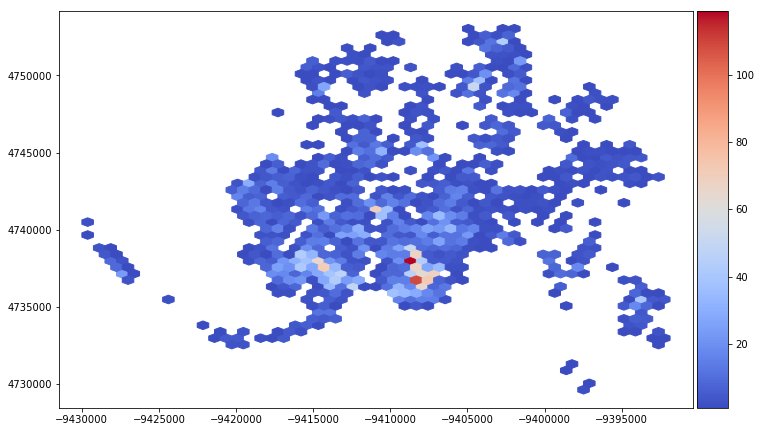

In [6]:
data_valid = raw_data.loc[raw_data.latitude_x.notnull()]
data_valid = data_valid.loc[data_valid.longitude_x.notnull()]
#ignore null longs or lats

from datashader.utils import lnglat_to_meters as webm
data_valid.loc[:, "longitude_x"], data_valid.loc[:, "latitude_x"], = webm(data_valid["longitude_x"],data_valid["latitude_x"])
#change lon, lat to x,y

#bound = gpd.read_file(cityBoundary)
#bound.crs = {'init': 'epsg:3857'}

crs = ccrs.epsg('3857') # web mercator
ax = plt.axes()

# convert to Web Mercator and plot the hexbins 
#X = data_valid.to_crs(epsg=3857)
vals = ax.hexbin(data_valid.longitude_x, data_valid.latitude_x, gridsize=50, mincnt=1, cmap='coolwarm')

ax.set_aspect('equal')

# larger figure
ax.figure.set_size_inches((12, 12))

# add a legend
#and make colorbar fit the size of figure
from mpl_toolkits.axes_grid1 import make_axes_locatable
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
cbar = plt.colorbar(vals,cax=cax)
cbar.ax.tick_params(labelsize=10)




## 2. Regression Analysis 

By exploring different possible factors that might have impact on numbers of overdoses of each tract, we run the linear regression model to verify this.

### 2.1 Predictors

In [7]:
#!pip install cenpy
#!pip install pysal
import cenpy as cen
import pysal
import requests

/Users/zhang/anaconda3/envs/musa620/lib/python3.6/site-packages/pysal/model/spvcm/abstracts.py:10: UserWarning: The `dill` module is required to use the sqlite backend fully.
  from .sqlite import head_to_sql, start_sql


Now we read data of some predictors. The data includes 311 requests, black and white people percentage, median income, balchelor percentage, crime level, disatance to vanant properties and distances to transit stations and hospitals.

We use census package to acquire census tract data of Cincinnati, instructions from https://github.com/datamade/census

In [8]:
#!pip install us
from census import Census
from us import states
MY_API_KEY = '97e85eda8a09ad9759d9cbc91a8d3f9eb71b9c0c'
c = Census(MY_API_KEY)

In [9]:
# population of all tracts of Hamilton County, from acs5 
population_raw = c.acs5.state_county_tract('B01003_001E', states.OH.fips, '061', Census.ALL)
population = pd.DataFrame(population_raw)
population = population.rename({'B01003_001E':'population'}, axis=1)

#  bachelor number of all tracts of Hamilton County, from acs5 
bachelor_raw = c.acs5.state_county_tract('B15003_022E', states.OH.fips, '061', Census.ALL)
bachelor = pd.DataFrame(bachelor_raw)
bachelor = bachelor.rename({'B15003_022E':'bachelor'}, axis=1)

#  black population of all tracts of Hamilton County, from acs5 
black_pop_raw = c.acs5.state_county_tract('B02001_003E', states.OH.fips, '061', Census.ALL)
black_pop = pd.DataFrame(black_pop_raw)
black_pop = black_pop.rename({'B02001_003E':'black_pop'}, axis=1)

#  white population of all tracts of Hamilton County, from acs5 
white_pop_raw = c.acs5.state_county_tract('B02001_002E', states.OH.fips, '061', Census.ALL)
white_pop = pd.DataFrame(white_pop_raw)
white_pop = white_pop.rename({'B02001_002E':'white_pop'}, axis=1)

#  median household income of all tracts of Hamilton County, from acs5 
median_hh_raw = c.acs5.state_county_tract('B19013_001E', states.OH.fips, '061', Census.ALL)
median_income = pd.DataFrame(median_hh_raw)
median_income = median_income.rename({'B19013_001E':'median_income'}, axis=1)

In [10]:
df1 = pd.merge(population, bachelor, on='tract', how='outer')
df2 = pd.merge(df1, black_pop, on='tract', how='outer')
df3 = pd.merge(df2, white_pop, on='tract', how='outer')
df4 = pd.merge(df3, median_income, on='tract', how='outer')

In [11]:
# calculte black and white percetage
demographic = df4[['tract','population','bachelor','black_pop','white_pop','median_income']]
demographic['black_pct'] = demographic['black_pop']/demographic['population']
demographic['white_pct'] = demographic['white_pop']/demographic['population']
demographic['bachelor_pct'] = demographic['bachelor']/demographic['population']

/Users/zhang/anaconda3/envs/musa620/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/zhang/anaconda3/envs/musa620/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
/Users/zhang/anaconda3/envs/musa620/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

We want to see how many ovdedose records are inside each census tract these years. The census tracts data contains tracts that beyond the city limit, so we only choose tracts within the city limit.

In [12]:
# intersect city boundary and all census tracts to get census tracts within city boundary
boundary = gpd.read_file(cityBoundary)
cts_raw = gpd.read_file('https://opendata.arcgis.com/datasets/d02e89ac4bfd47caa46c93a056dcbab9_0.geojson')
cts = gpd.overlay(boundary, cts_raw, how='intersection')

In [13]:
# select demographic data of census tracts within city boundary
cts = cts[['TRACTCE10','geometry']]
cts = cts.rename({'TRACTCE10':'tract'}, axis=1)
cts_demographic = pd.merge(cts, demographic, on='tract', how='inner')

In [14]:
cts_demographic.head()

,tract,geometry,population,bachelor,black_pop,white_pop,median_income,black_pct,white_pct,bachelor_pct
0,025104,(POLYGON ((-84.41357452291133 39.0585997697975...,1862.0,585.0,19.0,1749.0,166250.0,0.010204,0.939313,0.314178
1,025002,(POLYGON ((-84.36969552616698 39.0737372659736...,6823.0,1539.0,136.0,6495.0,88979.0,0.019933,0.951927,0.225561
2,004500,(POLYGON ((-84.40989906360086 39.0833943746703...,1034.0,170.0,12.0,997.0,92167.0,0.011605,0.964217,0.164410
3,004603,POLYGON ((-84.37303856194467 39.08145590495828...,3019.0,706.0,84.0,2746.0,66556.0,0.027824,0.909573,0.233852
4,004602,(POLYGON ((-84.37086892135163 39.0859844464269...,4832.0,1039.0,200.0,3919.0,49063.0,0.041391,0.811051,0.215025


Then we calculate number of hospitals and number of schools.

In [15]:
cts1 = cts_demographic

# read hospital geojson
hospitals = gpd.read_file('https://opendata.arcgis.com/datasets/0baa0cdf409e46e1800a6f08081bd9f7_1.geojson')
hospitals.crs = {'init' :'epsg:4326'}

# read school geojson
schools = gpd.read_file('https://opendata.arcgis.com/datasets/97194decd96d451cb9f67c19078b80c9_6.geojson')
schools.crs = {'init' :'epsg:4326'}

iv_dfsjoin1 = gpd.sjoin(cts1,hospitals)# spatil join census tracts and hospitals
hospital_count = iv_dfsjoin1.groupby('tract').count()[['GLOBALID']]
hospital_count = hospital_count.rename({'GLOBALID':'hospital_count'}, axis=1)

iv_dfsjoin2 = gpd.sjoin(cts1,schools)# spatil join census tracts and schools
school_count = iv_dfsjoin2.groupby('tract').count()[['GLOBALID']]
school_count = school_count.rename({'GLOBALID':'school_count'}, axis=1)

### 2.2 Dependent Variable

In [16]:
new_cts = cts_demographic

In [17]:
#create geometry from df1
from shapely.geometry import Point
points = gpd.GeoDataFrame(df0, geometry=[Point(x, y) for x, y in zip(df0.longitude_x, df0.latitude_x)])

points.head()

,latitude_x,longitude_x,incident_type_id,color,geometry
0,39.101675,-84.514038,HEROINP-COMBINED,red,POINT (-84.514038 39.1016750001196)
1,39.115051,-84.529110,HEROINP-COMBINED,red,POINT (-84.52911 39.1150510001195)
2,39.164528,-84.513777,HEROINP-COMBINED,red,POINT (-84.513777 39.1645280001195)
3,39.126231,-84.525635,HEROINP-COMBINED,red,POINT (-84.52563499999999 39.1262310001196)
4,39.164508,-84.535824,HEROINP-COMBINED,red,POINT (-84.53582400000001 39.1645080001195)


In [18]:
points.crs = {'init' :'epsg:4326'}
dv_dfsjoin = gpd.sjoin(new_cts,points)# spatil join census tracts and overdose points

In [19]:
# count overdose points inside each tract
od_count = dv_dfsjoin.groupby('tract').count()[['index_right']]
od_count = od_count.rename({'index_right':'od_count'}, axis=1)
od_count.head()

,od_count
tract,
000200,18
000700,268
000900,145
001000,55
001100,86


Now merge all dependent and independent variables, and calculate overdose rate by od_count divided by population inside each tract.

In [20]:
merge1 = pd.merge(cts_demographic, hospital_count, on='tract', how='outer')
merge2 = pd.merge(merge1, school_count, on='tract', how='outer')
final_df = pd.merge(merge2, od_count, on='tract', how='outer')
final_df['od_rate'] = final_df['od_count']/final_df['population']
final_df = final_df.fillna(0)

In [21]:
final_df

,tract,geometry,population,bachelor,black_pop,white_pop,median_income,black_pct,white_pct,bachelor_pct,hospital_count,school_count,od_count,od_rate
0,025104,(POLYGON ((-84.41357452291133 39.0585997697975...,1862.0,585.0,19.0,1749.0,166250.0,0.010204,0.939313,0.314178,0.0,0.0,0.0,0.000000
1,025002,(POLYGON ((-84.36969552616698 39.0737372659736...,6823.0,1539.0,136.0,6495.0,88979.0,0.019933,0.951927,0.225561,0.0,0.0,0.0,0.000000
2,004500,(POLYGON ((-84.40989906360086 39.0833943746703...,1034.0,170.0,12.0,997.0,92167.0,0.011605,0.964217,0.164410,0.0,0.0,4.0,0.003868
3,004603,POLYGON ((-84.37303856194467 39.08145590495828...,3019.0,706.0,84.0,2746.0,66556.0,0.027824,0.909573,0.233852,0.0,1.0,6.0,0.001987
4,004602,(POLYGON ((-84.37086892135163 39.0859844464269...,4832.0,1039.0,200.0,3919.0,49063.0,0.041391,0.811051,0.215025,0.0,3.0,45.0,0.009313
5,025001,(POLYGON ((-84.36957073546399 39.0749964865464...,6260.0,1548.0,62.0,6028.0,82868.0,0.009904,0.962939,0.247284,0.0,0.0,0.0,0.000000
6,004605,(POLYGON ((-84.41169303481355 39.1008944955807...,2516.0,492.0,237.0,2095.0,58650.0,0.094197,0.832671,0.195548,0.0,0.0,22.0,0.008744
7,004604,POLYGON ((-84.39448364121984 39.10524757245881...,3887.0,481.0,288.0,3329.0,51431.0,0.074093,0.856445,0.123746,0.0,0.0,62.0,0.015951
8,004702,POLYGON ((-84.40476674756641 39.13493087559406...,780.0,83.0,13.0,752.0,38646.0,0.016667,0.964103,0.106410,0.0,0.0,57.0,0.073077
9,026600,POLYGON ((-84.46571383669516 39.12193007521013...,1608.0,432.0,141.0,1404.0,70250.0,0.087687,0.873134,0.268657,0.0,1.0,82.0,0.050995


### 2.3 Regression 

Firstly we can create some interactive maps showing predictors and overdose rates using hvplot.

In [22]:
import hvplot.pandas

Now we do Linear Regression.

First we want to see the relationship of single predictors and the overdose rate.

Then we do the multivariable linear regression. We start by looking at the correlation matrix of predictors. 

It is not surprising that median income, percent of whites and percent of bachelors are strongly assoviated.

As we can see from the summary, the overdose rate is positively related with percent of blacks, percent of whites, number of hospitals and number of schools, but negatvely associated wth median household income. 

## 3. Clustering Analysis

Looking at how overdoses of different tracts in nearby neighborhoods have spatial relationships, whether they are clustered, or disparted, or randomly distributed.

We will create maps not only showing the clustering facts, but also give them interactive surfaces to generate detailed information of selected tract, such as population, median household income and bechalor number.

In [23]:
import altair as alt
from vega_datasets import data
alt.renderers.enable("notebook")

RendererRegistry.enable('notebook')

In [24]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

### DBSCAN

In [25]:
from sklearn.cluster import dbscan 

In [26]:
data2 = raw_data[['create_time_incident','latitude_x', 'longitude_x']]
data2 = data2.dropna()

In [27]:
# some parameters to start with
eps = 200 # in meters, maximum distance between two samples for one to be considered as in the neighborhood of the other
min_samples = 5 # number of samples (or total weight) in a neighborhood for a point to be considered as a core point

from datashader.utils import lnglat_to_meters as webm
data2.loc[:, "longitude_x"], data2.loc[:, "latitude_x"], = webm(data2["longitude_x"],data2["latitude_x"])
scaler = StandardScaler()
scaled_features = scaler.fit_transform(data2[['latitude_x', 'longitude_x']])

cores, labels = dbscan(data2[['longitude_x', 'latitude_x']], 
                       eps=eps, min_samples=min_samples)

# add our labels to the original data
data2['label'] = labels
# The number of clusters is the number of unique labels minus one (because noise has a label of -1)
num_clusters = data2['label'].nunique() - 1
print("number of clusters = ", num_clusters)


number of clusters =  140


In [28]:
print(len(cores))

4593


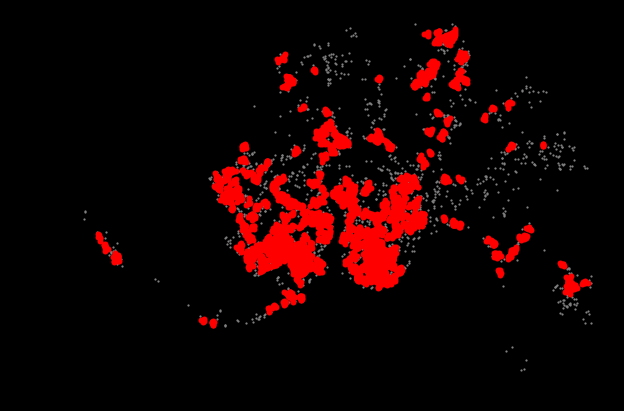

In [29]:
# Setup figure and axis
f, ax = plt.subplots(1, figsize=(10, 7), facecolor='black')

# Plot the noise samples in grey
noise = data2.loc[data2['label']==-1]
ax.scatter(noise['longitude_x'], noise['latitude_x'], c='grey', s=5, linewidth=0)

# loop over each cluster number
for label_num in range(num_clusters):
    
    # extract the samples with this label number
    this_cluster = data2.loc[data2['label'] == label_num]
    
    # plot the centroids
    ax.scatter(this_cluster['longitude_x'], this_cluster['latitude_x'], 
                linewidth=0, color='red')

# format and show
ax.set_axis_off()
plt.show()

In [30]:
N = data2.groupby('label').size()


# sort from largest to smallest
N = N.sort_values(ascending=False)
print(N)

# extract labels (ignoring label -1 for noise)
N2 = N.drop(labels=[-1])
top5 = list(N2.iloc[0:5].index)
print(top5)

label
 0      1189
-1      1005
 4       984
 9       204
 36      197
 45      153
 5       125
 13      104
 30       75
 20       74
 8        71
 3        70
 2        64
 39       62
 22       58
 33       47
 92       46
 48       36
 67       34
 96       33
 21       33
 47       32
 1        32
 10       30
 11       29
 101      28
 38       28
 123      27
 19       27
 98       24
        ... 
 68        6
 106       6
 66        6
 132       6
 100       6
 107       6
 94        6
 112       6
 133       5
 131       5
 128       5
 135       5
 136       5
 130       5
 97        5
 126       5
 25        5
 120       5
 118       5
 111       5
 109       5
 99        5
 54        5
 55        5
 138       5
 78        5
 85        5
 102       5
 139       5
 119       4
Length: 141, dtype: int64
[0, 4, 9, 36, 45]


## 4. Time-spatial Analysis

Looking at how overdose of each tract changes over the last three years (from 2016 to 2018) by creating a GIF image highlighting the concentrated tracts. The methods refer to Homework 5.

### 4.1 Overdose by months

In [31]:
import zipfile
import os
import urllib
import dask.dataframe as dd
import datashader as ds
import datashader.transfer_functions as tf

from datashader.colors import Greys9, inferno

In [32]:
# extract occur hour
data2['create_time_incident'] = pd.to_datetime(data2['create_time_incident'])
data2['month'] = data2.create_time_incident.dt.month

### 4.2 Overdose by years 

In [33]:
data3 = data2
data3['create_time_incident'] = pd.to_datetime(data3['create_time_incident'])
data3['year'] = data3.create_time_incident.dt.year

### 4.3 Overdose trend 

We can make plot of overdose counts by months and date.

In [34]:
data4 = data3.groupby(['year','month']).count()[['create_time_incident']]

In [35]:
data4 = data4.rename({'create_time_incident':'count'}, axis=1)
data4 = data4.reset_index()
data4

,year,month,count
0,2015,7,37
1,2015,8,113
2,2015,9,96
3,2015,10,104
4,2015,11,108
5,2015,12,91
6,2016,1,88
7,2016,2,90
8,2016,3,82
9,2016,4,88


In [36]:
data5 = data3
data5['date'] = data3.create_time_incident.dt.date
data5 = data5.groupby(['year','month','date']).count()[['create_time_incident']]
data5 = data5.rename({'create_time_incident':'count'}, axis=1)
data5 = data5.reset_index()
data5.hvplot(x='date',y='count',kind='bar')

:Bars   [date]   (count)

## 5. The Online Visualization 

In [37]:
import numpy as np
import pandas as pd
import geopandas as gpd
import requests

import holoviews as hv
import param as pm
import panel as pn

import altair as alt
import folium
from folium.plugins import HeatMap

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
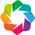

In [38]:
hv.extension('bokeh')
pn.extension('vega')
alt.renderers.enable('notebook');

In [39]:
MAX = 12
MIN = 1

# store the start/end dates of our data set
MIN_DATE = data2['month'].min()
MAX_DATE = data2['month'].max()

# store the default min/max date
DEFAULT_BOUNDS = (MIN_DATE, MAX_DATE)

In [40]:
data6 = raw_data[['create_time_incident','latitude_x', 'longitude_x']]
data6 = data6.dropna()
data6['create_time_incident'] = pd.to_datetime(data6['create_time_incident'])
data6['month'] = data3.create_time_incident.dt.month

In [41]:
class CincinnatiOverdoseApp(pm.Parameterized):
    """
    An app visualizing recent overdoses in Cincinnati. 
    
    It includes:
    - a Folium heatmap
    - a map showing overdose rates and demographic data
    - a Hvplot line chart

    """
    
    # the number of days to get data for
    month = pm.Integer(default=7, bounds=(MIN, MAX))
    
    # the x-axis selection on the daily shootings chart
    timeFilter = hv.streams.BoundsX(boundsx=DEFAULT_BOUNDS)
    
    
    def filter_by_month(self):
        """
        Return the subset of the full data set ('data2') that 
        occurred in the selected month.
        """
        # select data based on month
        selection = data6[data6['month'] == self.month]  

        # only return subset of data that is necessary
        return selection
    
    @pm.depends("month", watch=True)
    def _reset_timeFilter(self):
        """
        Internal function that resets the time filter to the default limits
        """
        self.timeFilter.update(boundsx=DEFAULT_BOUNDS)
    

    @pm.depends("month")
    def heatmap(self):
        """
        Return a Folium map with a heatmap showing the currently 
        selected data.
        """
        # initialize the Folium map
        m3 = folium.Map(
                location=[39.15, -84.55],
                zoom_start=11,
                tiles="Stamen Toner"
        )

        # get the filtered data
        data = self.filter_by_month()

        # convert to coordinates array
        coordinates = data[['latitude_x', 'longitude_x']].values

        # add heat map
        folium.GeoJson(cityBoundary).add_to(m3)
        HeatMap(coordinates).add_to(m3)
        # IMPORTANT: add map to a folium Figure
        # return a figure with a set width/height
        figure = folium.Figure(width=700, height=400)
        m3.add_to(figure)

        # return the Pane object
        return pn.Pane(figure)
    
    
    def hvplotmap(self):
        figure = final_df.hvplot(c='od_rate', width=700, height=400, dynamic=False,  
                                 cmap='coolwarm' , title = 'Overdose Rate (2015-2018)')

        # return the Pane object
        return pn.Pane(figure)
    
    def barplot(self):
        figure = data5.hvplot(x='date',y='count',kind='line',width = 1400,title = 'Overdose Count by date')

        # return the Pane object
        return pn.Pane(figure)
    
  

In [42]:
app = CincinnatiOverdoseApp(name="")

# Create some HTML elements
title = pn.Pane("<h2>Heroin Overdose in Cincinnati</h2>", width=500)
instructions = pn.Pane(
    """
<div font-size=28px><b>Note:</b> From he summer of 2015 to the summer of 2018, there are more than
6000 heroin overdose reports in Cincinnati, Ohio. This page shows situation and trend of heroin overdose in that city.</div>""",
    width=500,
)

panel = pn.Column(
    pn.Row(pn.Column(pn.Row(title))),
    pn.Row(pn.Row(app.param),instructions, align="center"),
    pn.Row(app.heatmap,app.hvplotmap, align="center"),
    pn.Row(app.barplot)
)

panel.servable()

Column
    [0] Row
        [0] Column
            [0] Row
                [0] Markdown(str, width=500)
    [1] Row(align='center')
        [0] Row
            [0] Column(name='Param01420', width=300)
                [0] StaticText(value='<b></b>')
                [1] IntSlider(end=12, name='Month', start=1, value=7)
        [1] Markdown(str, width=500)
    [2] Row(align='center')
        [0] ParamMethod(method)
        [1] ParamMethod(method)
    [3] Row
        [0] ParamMethod(method)